# Объектно-центрированное обучение с подкреплением с прогнозирующими моделями

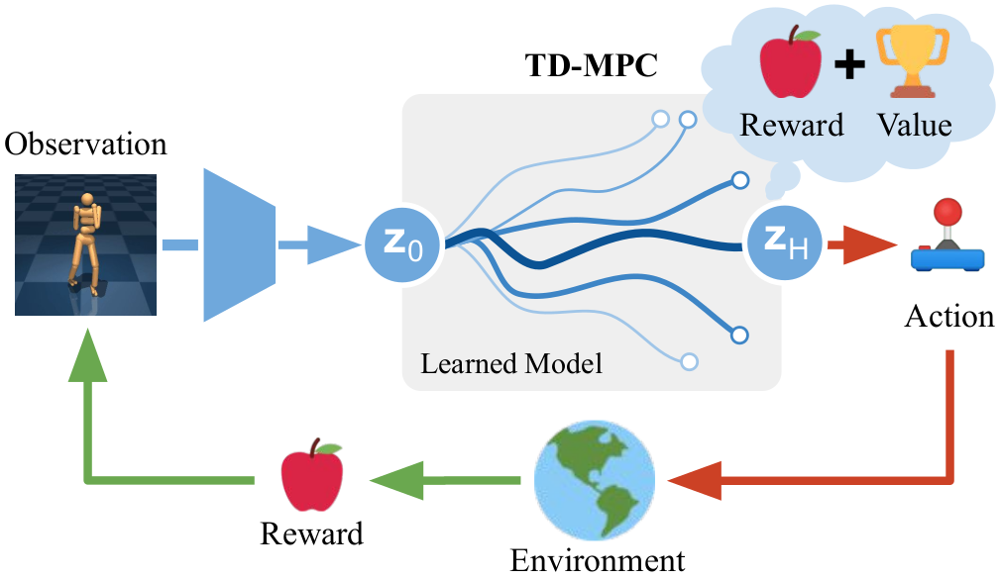

# 1 Object-Centric TD-MPC2
Компоненты: 
- $\boldsymbol{z}_t = \{z_t ^ 1, \dots, z_t ^ K \} = \text{Dinosaur}(observation_t)$
- $\hat{\boldsymbol{z}}_{t + 1} = \text{OCDynamicsModel}(\boldsymbol{z}_t, action_t)$
- $\hat{reward}_t = \text{OCRewardModel}(\boldsymbol{z}_t, action_t)$
- $\hat{q}_t = \text{OCQModel}(\boldsymbol{z}_t, action_t)$
- $\hat{action}_t = \text{OCPolicyModel}(\boldsymbol{z}_t)$

## 1.1 OCDynamicsModel

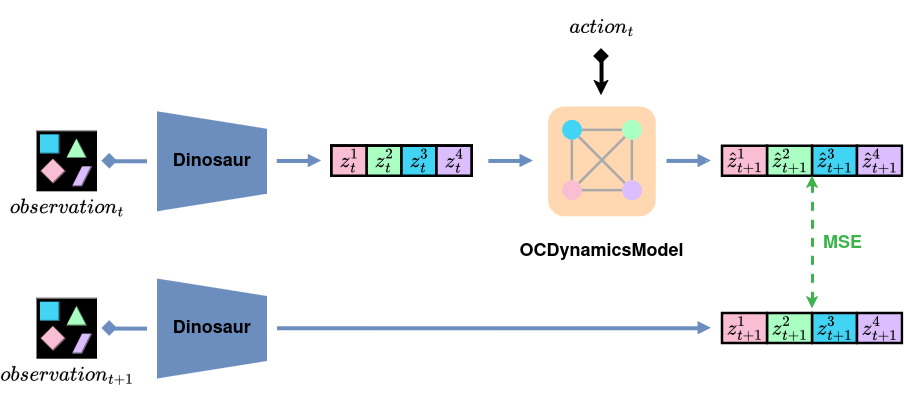

### Message Passing Graph Neural Networks
- Рассматриваем множество слотов $\boldsymbol{z}_t = \{z_t ^ 1, \dots, z_t ^ K \}$ как полный граф и применяем GNN
- GNN состоит из двух MLP моделей: модель ребра $\text{edge}$ и модель вершины $\text{node}$
- Схема применения GNN гарантирует эквивариантность $\hat{\boldsymbol{z}}_{t+1}$ относительно $\boldsymbol{z}_t$

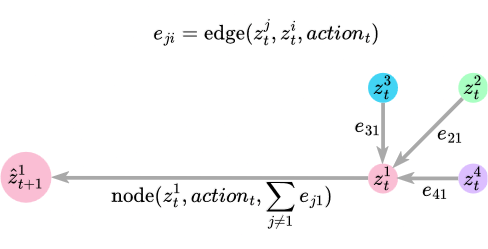

## 1.2 OCRewardModel
 - $\boldsymbol{h} = \{h ^ 1, \dots, h ^ K\} = \text{GNN}(\boldsymbol{z}_t, action_t)$
 - $\text{READOUT}$ (mean): $embedding_t ^ {reward} = \sum_{i = 1} ^ K h ^ i / K$
 - В качества $\text{READOUT}$ можно взять любую функцию, инвариантную относительно порядка слотов в $\boldsymbol{z}_t$: sum, min, max, ...

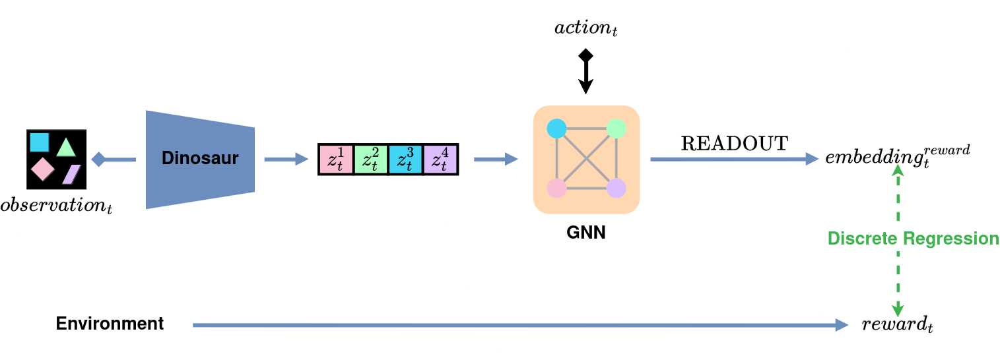

## 1.3 OCPolicy
- Отличается от OCRewardModel тем, что зависит только от слотов, но не от действия: GNN($\boldsymbol{z}_t$)
- Моделирует нормальное распределение действий, выдавая мат. ожидание и дисперсию 

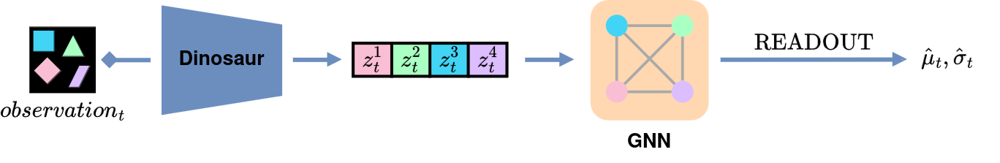

## 1.4 OCQModel
- Архитектура совпадает с OCRewardModel
- В отличие от OCRewardModel, используется ансамбль моделей

## 1.5 Обучение
Для обучения из буфера прецедентов семплируются отрезки траекторий длины $H$.
- OCDynamicsModel, OCRewardModel, OCQModel: $L(\theta) = \mathbb{E}_{(z_t, action_t, reward_t) \sim \mathcal{B}, \ \ t = [0:H]} \sum_{t = 0} ^ H \lambda ^ t \left[ \lVert \hat{\boldsymbol{z}}_{t+1} - \boldsymbol{z}_{t + 1} \rVert ^ 2 + \text{CE}(\hat{reward}_t, reward_t) + \text{CE}\left( \hat{q}_t, reward_t + \gamma \text{OCQModel} ^ {target} (\boldsymbol{z}_{t + 1}, \hat{action}_{t+1}) \right) \right]$
- OCPolicyModel: $L(\theta) = \mathbb{E}_{(\boldsymbol{z}_t, action_t) \sim \mathcal{B}, \ \ t=[0:H]} \sum_{t = 0} ^ H \lambda ^ t \left[ \alpha \text{OCQModel}(\boldsymbol{z}_{t + 1}, \hat{action}_{t+1}) - \beta \mathcal{H}\left(\mathcal{N}(\cdot | \hat{\mu}_t, \hat{\sigma}_t)\right) \right]$

# 2 Пример реализации OCRewardModel
Обучение OCRewardModel на 100 траекториях <слоты, действия, вознаграждения> для задачи Block Lifting в среде Robosuite.

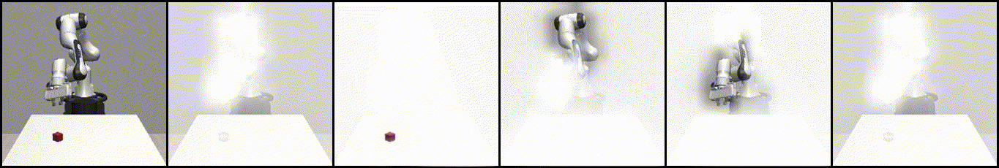

In [ ]:
import numpy as np
import torch
import torch.nn as nn
import wandb

# Класс GNN реализован в tdmpc2/common/layers.py
import common.layers

In [ ]:
! wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1hMlBY9XUHp9EbYc7xuDz1Z0oPS4PcHiM' -O actions.npy
! wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1qfA3DWmVBf4HLJkil0MwJUpHRDNi6Z9A' -O rewards.npy
! wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1Alp-C9JYio7eGiDh_UTNnCyVDMRDmMWm' -O slots.npy

In [ ]:
actions_total = np.load('actions.npy').astype(np.float32)
rewards_total = np.load('rewards.npy')[:, np.newaxis].astype(np.float32)
slots_total = np.load('slots.npy').astype(np.float32)

print(f'actions={actions_total.shape} rewards={rewards_total.shape} slots={slots_total.shape}')

In [ ]:
train_size = 12500

train_actions, val_actions = np.split(actions_total, [train_size,])
train_rewards, val_rewards = np.split(rewards_total, [train_size,])
train_slots, val_slots = np.split(slots_total, [train_size,])

In [ ]:
learning_rate = 1e-4

class OCRewardModel(nn.Module):
    def __init__(self, n_slots, slot_dim, latent_dim, action_dim):
        super().__init__()
        self.n_slots = n_slots
        self.slot_dim = slot_dim
        self.latent_dim = latent_dim
        self.action_dim = action_dim
        self.act = nn.ReLU(inplace=True)
        self.gnn = common.layers.GNN(input_dim=self.slot_dim, hidden_dim=self.latent_dim, action_dim=self.action_dim,
                              num_objects=self.n_slots, ignore_action=False, copy_action=True, edge_actions=True)

        # READOUT layer
        self.mlp = nn.Linear(in_features=self.slot_dim, out_features=1)

    def forward(self, slots, action):
        x = self.gnn(slots, action)
        x = self.act(x)

        # READOUT
        return self.mlp(x.mean(dim=1))

reward_model = OCRewardModel(
    n_slots=train_slots.shape[1], slot_dim=train_slots.shape[2], latent_dim=512, action_dim=train_actions.shape[1]
).to('cuda')

optimizer = torch.optim.Adam(reward_model.parameters(), lr=learning_rate, eps=1e-5)
loss_fn = nn.MSELoss(reduction='mean')

In [ ]:
wandb.init(project='OCRewardModel', name='run-0')

In [ ]:
batch_size = 512

def one_pass(actions_set, rewards_set, slots_set, do_need_train=True):
    indices = np.random.choice(a=actions_set.shape[0], size=actions_set.shape[0], replace=False)
    num_batches = actions_set.shape[0] // batch_size
    losses = []
    for i in range(num_batches):
        slc = np.s_[i * batch_size: (i + 1) * batch_size]
        actions = torch.as_tensor(actions_set[slc], device='cuda')
        rewards = torch.as_tensor(rewards_set[slc], device='cuda')
        slots = torch.as_tensor(slots_set[slc], device='cuda')
        rewards_predict = reward_model(slots, actions)
        loss = loss_fn(rewards_predict, rewards)
        losses.append(loss.item())
        if do_need_train:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    return np.mean(losses)

for epoch in range(100):
    train_loss = one_pass(train_actions, train_rewards, train_slots, do_need_train=True)
    val_loss = one_pass(val_actions, val_rewards, val_slots, do_need_train=False)
    record = {'epoch': epoch, 'train_loss': train_loss, 'val_loss': val_loss}
    print(record)
    wandb.log(record)

wandb.finish()

# 3 Реализация Object-Centric TD-MPC2
 - Среды: Robosuite - задача Block Lifting и ManiSkill - задача PushCube-v1 (опционально)
 - Веса предобученных моделей Dinosaur: [Block Lifting (Robosuite)](https://drive.google.com/file/d/1dj5Oq-iP-wDTC7StOOsNHULxONDQZ8LQ/view?usp=drive_link) и [PushCube-v1 (ManiSkill)](https://drive.google.com/file/d/1v0gjazJPzBLyWDgBmwtDBnBVNXbVokf7/view?usp=sharing)
 - Код объектно-центрированной модели OCWorldModel с небольшими изменениями повторяет код оригинальной модели TD-MPC2 WorldModel (tdmpc2/common/world_model.py)
 - Задача - реализация классов: OCDynamicsModel, OCRewardModel, OCPolicy

Запуск Object-Centric TD-MPC2 для задачи Block Lifting в среде Robosuite:
```
export WANDB_API_KEY=${your_wandb_api_key}
python tdmpc2/train.py task=lift obs=slots obs_size=224 time_limit=125 model_size=48 batch_size=512 seed=0 eval_episodes=30 eval_freq=50000 n_slots=5 slot_dim=64 slot_extractor_checkpoint_path=${path/to/dinosaur/checkpoint} wandb_project=tdmpc2_robosuite_lift wandb_entity=${your_entity_name} wandb_group_name=slots wandb_run_name=slots disable_wandb=false
```

Запуск Object-Cenric TD-MPC2 для задачи PushCube-v1 в среде ManiSkill (опционально):
```
export WANDB_API_KEY=${your_wandb_api_key}
python tdmpc2/train.py task=push-cube obs=slots obs_size=224 time_limit=100 model_size=48 batch_size=512 seed=0 eval_episodes=30 eval_freq=50000 dino_model_name=vit_small_patch8_224_dino n_slots=4 slot_dim=128 input_feature_dim=384 num_patches=784 features=\[1024,1024,1024\] slot_extractor_checkpoint_path=${path/to/dinosaur/checkpoint} wandb_project=tdmpc2_maniskill_push-cube wandb_entity=${your_entity_name} wandb_group_name=slots wandb_run_name=slots disable_wandb=false
```

## 3.1 Результаты оригинального TD-MPC2
Запуск оригинального TD-MPC2 для задачи Block Lifting в среде Robosuite ([метрики](https://wandb.ai/ula_elfray/tdmpc2_robosuite-lift)):
```
export WANDB_API_KEY=${your_wandb_api_key}
python tdmpc2/train.py task=lift obs=rgb obs_size=64 time_limit=125 model_size=48 batch_size=512 seed=0 eval_episodes=30 eval_freq=50000 wandb_project=tdmpc2_robosuite_lift wandb_entity=${your_entity_name} wandb_group_name=monolithic wandb_run_name=monolithic disable_wandb=false
```
Запуск оригинального TD-MPC2 для задачи PushCube-v1 в среде ManiSkill ([метрики](https://wandb.ai/ula_elfray/tdmpc2_maniskill-push-cube)):
```
export WANDB_API_KEY=${your_wandb_api_key}
python tdmpc2/train.py task=push-cube obs=rgb obs_size=64 time_limit=100 model_size=48 batch_size=512 seed=0 eval_episodes=30 eval_freq=50000 wandb_project=tdmpc2_maniskill_push-cube wandb_entity=${your_entity_name} wandb_group_name=monolithic wandb_run_name=monolithic disable_wandb=false
```